In [1]:
import stlearn as st
from pathlib import Path
import pandas as pd

In [2]:
from matplotlib import pyplot as plt
from PIL import Image
import pandas as pd
import matplotlib
import numpy as np

from stlearn._compat import Literal
from typing import Optional, Union
from anndata import AnnData
import warnings
#from .utils import get_img_from_fig, checkType


def gene_plot(
    adata: AnnData,
    method: str = "CumSum",
    genes: Optional[Union[str, list]] = None,
    threshold: float = None,
    library_id: str = None,
    data_alpha: float = 1.0,
    tissue_alpha: float = 1.0,
    cmap: str = "Spectral_r",
    spot_size: Union[float, int] = 6.5,
    show_legend: bool = False,
    show_color_bar: bool = True,
    show_axis: bool = False,
    cropped: bool = True,
    margin: int = 100,
    name: str = None,
    output: str = None,
    copy: bool = False,
) -> Optional[AnnData]:
    """\
    Gene expression plot for sptial transcriptomics data.
    Parameters
    ----------
    adata
        Annotated data matrix.
    library_id
        Library id stored in AnnData.
    method
        Use method to count. We prorive: NaiveMean, NaiveSum, CumSum.
    genes
        Choose a gene or a list of genes.
    threshold
        Threshold to filter genes
    data_alpha
        Opacity of the spot.
    tissue_alpha
        Opacity of the tissue.
    cmap
        Color map to use.
    spot_size
        Size of the spot.
    show_color_bar
        Show color bar or not.
    show_axis
        Show axis or not.
    show_legend
        Show legend or not.
    show_trajectory
        Show the spatial trajectory or not. It requires stlearn.spatial.trajectory.pseudotimespace.
    show_subcluster
        Show subcluster or not. It requires stlearn.spatial.trajectory.global_level.
    name
        Name of the output figure file.
    output
        Save the figure as file or not.
    copy
        Return a copy instead of writing to adata.
    Returns
    -------
    Nothing
    """

    #plt.rcParams['figure.dpi'] = dpi

    if type(genes) == str:
        genes = [genes]
    colors = _gene_plot(adata, method, genes)

    if threshold is not None:
        colors = colors[colors>threshold]

    index_filter = colors.index

    filter_obs  = adata.obs.loc[index_filter]

    imagecol = filter_obs["imagecol"]
    imagerow = filter_obs["imagerow"]
    
    # Option for turning off showing figure
    plt.ioff()

    # Initialize matplotlib
    fig, a = plt.subplots()

    vmin = min(colors)
    vmax = max(colors)
    # Plot scatter plot based on pixel of spots
    plot = a.scatter(imagecol, imagerow, edgecolor="none", alpha=data_alpha, s=spot_size, marker="o",
                     vmin=vmin, vmax=vmax, cmap=plt.get_cmap(cmap), c=colors)

    if show_color_bar:

        cb = plt.colorbar(plot, cax=fig.add_axes(
            [0.9, 0.3, 0.03, 0.38]), cmap=cmap)
        cb.outline.set_visible(False)

    if not show_axis:
        a.axis('off')

    if library_id is None:
        library_id = list(adata.uns["spatial"].keys())[0]

    image = adata.uns["spatial"][library_id]["images"][adata.uns["spatial"]["use_quality"]]
    # Overlay the tissue image
    a.imshow(image, alpha=tissue_alpha, zorder=-1,)

    if cropped:
        imagecol = adata.obs["imagecol"]
        imagerow = adata.obs["imagerow"]

        a.set_xlim(imagecol.min() - margin,
                imagecol.max() + margin)

        a.set_ylim(imagerow.min() - margin,
                imagerow.max() + margin)
        
        a.set_ylim(a.get_ylim()[::-1])

    if name is None:
        name = method
    if output is not None:
        fig.savefig(output + "/" + name, dpi=plt.figure().dpi,
                    bbox_inches='tight', pad_inches=0)
        
    


    plt.show()



def _gene_plot(adata, method, genes):

    # Gene plot option

    if len(genes) == 0:
        raise ValueError('Genes shoule be provided, please input genes')

    elif len(genes) == 1:

        if genes[0] not in adata.var.index:
            raise ValueError(
                genes[0] + ' is not exist in the data, please try another gene')

        colors = adata[:, genes].to_df().iloc[:, -1]

        return colors
    else:

        for gene in genes:
            if gene not in adata.var.index:
                genes.remove(gene)
                warnings.warn("We removed " + gene +
                              " because they not exist in the data")

            if len(genes) == 0:
                raise ValueError(
                    'All provided genes are not exist in the data')

        count_gene = adata[:, genes].to_df()

        if method is None:
            raise ValueError(
                'Please provide method to combine genes by NaiveMean/NaiveSum/CumSum')

        if method == "NaiveMean":
            present_genes = (count_gene > 0).sum(axis=1) / len(genes)

            count_gene = (count_gene.mean(axis=1)) * present_genes
        elif method == "NaiveSum":
            present_genes = (count_gene > 0).sum(axis=1) / len(genes)

            count_gene = (count_gene.sum(axis=1)) * present_genes

        elif method == "CumSum":
            count_gene = count_gene.cumsum(axis=1).iloc[:, -1]

        colors = count_gene

        return colors


"""Reading and Writing
"""
from pathlib import Path, PurePath
from typing import Optional, Union
from anndata import AnnData
import numpy as np
from PIL import Image
import pandas as pd
import stlearn
import scanpy
import scipy

def Read10X(
    path: Union[str, Path],
    genome: Optional[str] = None,
    count_file: str = "filtered_feature_bc_matrix.h5",
    library_id: str = None,
    load_images: Optional[bool] = True,
    quality: str = "hires"
    ) -> AnnData:
    
    """\
    Read Visium data from 10X (wrap read_visium from scanpy)

    In addition to reading regular 10x output,
    this looks for the `spatial` folder and loads images,
    coordinates and scale factors.
    Based on the `Space Ranger output docs`_.

    .. _Space Ranger output docs: https://support.10xgenomics.com/spatial-gene-expression/software/pipelines/latest/output/overview

    Parameters
    ----------
    path
        Path to directory for visium datafiles.
    genome
        Filter expression to genes within this genome.
    count_file
        Which file in the passed directory to use as the count file. Typically would be one of:
        'filtered_feature_bc_matrix.h5' or 'raw_feature_bc_matrix.h5'.
    library_id
        Identifier for the visium library. Can be modified when concatenating multiple adata objects.
    load_images
        Load image or not.
    quality
        Set quality that convert to stlearn to use. Store in anndata.obs['imagecol' & 'imagerow']


    Returns
    -------
    Annotated data matrix, where observations/cells are named by their
    barcode and variables/genes by gene name. Stores the following information:
    :attr:`~anndata.AnnData.X`
        The data matrix is stored
    :attr:`~anndata.AnnData.obs_names`
        Cell names
    :attr:`~anndata.AnnData.var_names`
        Gene names
    :attr:`~anndata.AnnData.var`\\ `['gene_ids']`
        Gene IDs
    :attr:`~anndata.AnnData.var`\\ `['feature_types']`
        Feature types
    :attr:`~anndata.AnnData.uns`\\ `['spatial']`
        Dict of spaceranger output files with 'library_id' as key
    :attr:`~anndata.AnnData.uns`\\ `['spatial'][library_id]['images']`
        Dict of images (`'hires'` and `'lowres'`)
    :attr:`~anndata.AnnData.uns`\\ `['spatial'][library_id]['scalefactors']`
        Scale factors for the spots
    :attr:`~anndata.AnnData.uns`\\ `['spatial'][library_id]['metadata']`
        Files metadata: 'chemistry_description', 'software_version'
    :attr:`~anndata.AnnData.obsm`\\ `['spatial']`
        Spatial spot coordinates, usable as `basis` by :func:`~scanpy.pl.embedding`.
    """
    
    from scanpy import read_visium
    adata = read_visium(path, genome=None,
     count_file=count_file,
      library_id=library_id,
       load_images=True)
    adata.var_names_make_unique()

    adata.obs['sum_counts'] = np.array(adata.X.sum(axis=1))

    
    if library_id is None:
        library_id = list(adata.uns["spatial"].keys())[0]
        
    scale = adata.uns["spatial"][library_id]["scalefactors"]["tissue_"+quality+"_scalef"]
    image_coor = adata.obsm["spatial"]*scale

    adata.obs["imagecol"] = image_coor[:,0]
    adata.obs["imagerow"] = image_coor[:,1]
    adata.uns["spatial"]["use_quality"] = quality

    return adata


def ReadOldST(
    count_matrix_file: Union[str, Path] = None,
    spatial_file: Union[str, Path] = None,
    image_file: Union[str, Path] = None,
    library_id: str = "OldST",
    scale: float = 1.0,
    quality: str = "hires"
    ) -> AnnData:

    """\
    Read Old Spatial Transcriptomics data

    Parameters
    ----------
    count_matrix_file
        Path to count matrix file.
    spatial_file
        Path to spatial location file.
    image_file
        Path to the tissue image file
    library_id
        Identifier for the visium library. Can be modified when concatenating multiple adata objects.
    scale
        Set scale factor.
    quality
        Set quality that convert to stlearn to use. Store in anndata.obs['imagecol' & 'imagerow']
    Returns
    -------
    AnnData
    """

    adata = stlearn.read.file_table(count_matrix_file)
    adata=stlearn.add.parsing(adata,
        coordinates_file = spatial_file)
    stlearn.add.image(adata, library_id=library_id, quality=quality,imgpath=image_file, scale=scale)

    adata.obs['sum_counts'] = np.array(adata.X.sum(axis=1))

    return adata

In [3]:
BASE_PATH = Path("/scratch/imb/Xiao/unet")



In [301]:
SAMPLE = "Sample1"
Sample1 = ReadOldST(count_matrix_file=BASE_PATH / ("count_data/JVQN_Brain_"+SAMPLE[-1]+"_S"+SAMPLE[-1]+"_stdata.tsv"),
                    spatial_file=BASE_PATH / ("spot_info/spot_data-selection-CY3_"+SAMPLE+"_all.tsv"),
                    image_file=BASE_PATH / ("images/HE_"+SAMPLE+".jpg"),
                    library_id=SAMPLE)
Sample1_features = pd.read_csv(BASE_PATH / ("features/train/"+SAMPLE+".csv"), index_col=0)
Sample1.obs["f_index"] = Sample1.obs["imagerow"].astype(str) + "-" + Sample1.obs["imagecol"].astype(str)
Sample1_features = Sample1_features.reindex(Sample1.obs["f_index"])
Sample1_features.index = Sample1.obs_names
Sample1.obsm["features"] = Sample1_features

Added tissue image to the object!


In [302]:
SAMPLE = "Sample2"
Sample2 = ReadOldST(count_matrix_file=BASE_PATH / ("count_data/JVQN_Brain_"+SAMPLE[-1]+"_S"+SAMPLE[-1]+"_stdata.tsv"),
                    spatial_file=BASE_PATH / ("spot_info/spot_data-selection-CY3_"+SAMPLE+"_all.tsv"),
                    image_file=BASE_PATH / ("images/HE_"+SAMPLE+".jpg"),
                    library_id=SAMPLE)
Sample2_features = pd.read_csv(BASE_PATH / ("features/train/"+SAMPLE+".csv"), index_col=0)
Sample2.obs["f_index"] = Sample2.obs["imagerow"].astype(str) + "-" + Sample2.obs["imagecol"].astype(str)
Sample2_features = Sample2_features.reindex(Sample2.obs["f_index"])
Sample2_features.index = Sample2.obs_names
Sample2.obsm["features"] = Sample2_features

Added tissue image to the object!


In [303]:
SAMPLE = "Sample3"
Sample3 = ReadOldST(count_matrix_file=BASE_PATH / ("count_data/JVQN_Brain_"+SAMPLE[-1]+"_S"+SAMPLE[-1]+"_stdata.tsv"),
                    spatial_file=BASE_PATH / ("spot_info/spot_data-selection-CY3_"+SAMPLE+"_all.tsv"),
                    image_file=BASE_PATH / ("images/HE_"+SAMPLE+".jpg"),
                    library_id=SAMPLE)
Sample3_features = pd.read_csv(BASE_PATH / ("features/train/"+SAMPLE+".csv"), index_col=0)
Sample3.obs["f_index"] = Sample3.obs["imagerow"].astype(str) + "-" + Sample3.obs["imagecol"].astype(str)
Sample3_features = Sample3_features.reindex(Sample3.obs["f_index"])
Sample3_features.index = Sample3.obs_names
Sample3.obsm["features"] = Sample3_features

Added tissue image to the object!


In [304]:
SAMPLE = "Sample4"
Sample4 = ReadOldST(count_matrix_file=BASE_PATH / ("count_data/JVQN_Brain_"+SAMPLE[-1]+"_S"+SAMPLE[-1]+"_stdata.tsv"),
                    spatial_file=BASE_PATH / ("spot_info/spot_data-selection-CY3_"+SAMPLE+"_all.tsv"),
                    image_file=BASE_PATH / ("images/HE_"+SAMPLE+".jpg"),
                    library_id=SAMPLE)
Sample4_features = pd.read_csv(BASE_PATH / ("features/valid/"+SAMPLE+".csv"), index_col=0)
Sample4.obs["f_index"] = Sample4.obs["imagerow"].astype(str) + "-" + Sample4.obs["imagecol"].astype(str)
Sample4_features = Sample4_features.reindex(Sample4.obs["f_index"])
Sample4_features.index = Sample4.obs_names
Sample4.obsm["features"] = Sample4_features

Added tissue image to the object!


In [305]:
SAMPLE = "Sample5"
Sample5 = ReadOldST(count_matrix_file=BASE_PATH / ("count_data/JVQN_Brain_"+SAMPLE[-1]+"_S"+SAMPLE[-1]+"_stdata.tsv"),
                    spatial_file=BASE_PATH / ("spot_info/spot_data-selection-CY3_"+SAMPLE+"_all.tsv"),
                    image_file=BASE_PATH / ("images/HE_"+SAMPLE+".jpg"),
                    library_id=SAMPLE)
Sample5_features = pd.read_csv(BASE_PATH / ("features/test/"+SAMPLE+".csv"), index_col=0)
Sample5.obs["f_index"] = Sample5.obs["imagerow"].astype(str) + "-" + Sample5.obs["imagecol"].astype(str)
Sample5_features = Sample5_features.reindex(Sample5.obs["f_index"])
Sample5_features.index = Sample5.obs_names
Sample5.obsm["features"] = Sample5_features

Added tissue image to the object!


In [306]:
SAMPLE = "Sample6"
Sample6 = ReadOldST(count_matrix_file=BASE_PATH / ("count_data/JVQN_Brain_"+SAMPLE[-1]+"_S"+SAMPLE[-1]+"_stdata.tsv"),
                    spatial_file=BASE_PATH / ("spot_info/spot_data-selection-CY3_"+SAMPLE+"_all.tsv"),
                    image_file=BASE_PATH / ("images/HE_"+SAMPLE+".jpg"),
                    library_id=SAMPLE)
Sample6_features = pd.read_csv(BASE_PATH / ("features/test/"+SAMPLE+".csv"), index_col=0)
Sample6.obs["f_index"] = Sample6.obs["imagerow"].astype(str) + "-" + Sample6.obs["imagecol"].astype(str)
Sample6_features = Sample6_features.reindex(Sample6.obs["f_index"])
Sample6_features.index = Sample6.obs_names
Sample6.obsm["features"] = Sample6_features

Added tissue image to the object!


In [307]:
# Plp1 Aqp4 ERMN Apold1 Ccl4 Reln Pdgfra Dsp
gene_list=["ENSMUSG00000031425", "ENSMUSG00000024411", "ENSMUSG00000026830", 
           "ENSMUSG00000090698", "ENSMUSG00000018930", "ENSMUSG00000042453",
           "ENSMUSG00000029231", "ENSMUSG00000054889"]

In [308]:
for adata in [
    Sample1,
    Sample2,
    Sample3,
    Sample4,
    Sample5,
    Sample6,
]:
    count_df = adata.to_df()
    count_df[count_df <1] = 0
    count_df[count_df >=1] = 1
    adata.X = count_df
    adata[:,gene_list]
    
    
    

In [309]:
training_dataset = Sample1.concatenate(
    [Sample2, Sample3],
    batch_key="library_id",
    uns_merge="unique",
    batch_categories=[
        k
        for d in [
            Sample1.uns["spatial"],
            Sample2.uns["spatial"],
            Sample3.uns["spatial"],
        ]
        for k in [list(d.keys())[0]]
    ],
)

In [310]:
valid_dataset = Sample4.copy()

In [311]:
test_dataset = Sample5.concatenate(
    [Sample6],
    batch_key="library_id",
    uns_merge="unique",
    batch_categories=[
        k
        for d in [
            Sample5.uns["spatial"],
            Sample6.uns["spatial"],
        ]
        for k in [list(d.keys())[0]]
    ],
)

In [312]:
All_dataset = Sample1.concatenate(
    [Sample2, Sample3, Sample4, Sample5, Sample6],
    batch_key="library_id",
    uns_merge="unique",
    batch_categories=[
        k
        for d in [
            Sample1.uns["spatial"],
            Sample2.uns["spatial"],
            Sample3.uns["spatial"],
            Sample4.uns["spatial"],
            Sample5.uns["spatial"],
            Sample6.uns["spatial"],
        ]
        for k in [list(d.keys())[0]]
    ],
)

In [313]:
train_X = training_dataset.obsm["features"]
train_Y = training_dataset[:,gene_list].to_df()

In [314]:
valid_X = valid_dataset.obsm["features"]
valid_Y = valid_dataset[:,gene_list].to_df()

In [315]:
test_X = test_dataset.obsm["features"]
test_Y = test_dataset[:,gene_list].to_df()

In [316]:
import pathlib

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.losses import BinaryCrossentropy

print(tf.__version__)

2.2.0


In [317]:
def build_model():
    model = keras.Sequential([
        layers.Dense(512, activation='relu', input_shape=(2048,)),
        layers.Dropout(0.8),
        layers.Dense(256, activation='relu'),
        layers.Dense(8, activation='softmax')
    ])

    optimizer = tf.keras.optimizers.RMSprop(0.0001)

    model.compile(loss=BinaryCrossentropy(),
                optimizer=optimizer,
                metrics=[BinaryCrossentropy(), "acc"])
    return model

In [318]:
model = build_model()

In [319]:
EPOCHS = 200

history = model.fit(
  train_X, train_Y, batch_size=100,
  epochs=EPOCHS, validation_data = (valid_X, valid_Y), validation_batch_size = 100)

Epoch 1/200
20/20 [==============================] - ETA: 0s - loss: 1.0706 - binary_crossentropy: 1.0706 - acc: 0.180 - ETA: 0s - loss: 0.6608 - binary_crossentropy: 0.6608 - acc: 0.705 - 0s 11ms/step - loss: 0.6095 - binary_crossentropy: 0.6067 - acc: 0.7210 - val_loss: 0.3070 - val_binary_crossentropy: 0.2934 - val_acc: 0.9904
Epoch 2/200
20/20 [==============================] - ETA: 0s - loss: 0.3309 - binary_crossentropy: 0.3309 - acc: 0.860 - ETA: 0s - loss: 0.4386 - binary_crossentropy: 0.4386 - acc: 0.785 - 0s 7ms/step - loss: 0.4206 - binary_crossentropy: 0.4204 - acc: 0.7929 - val_loss: 0.2036 - val_binary_crossentropy: 0.1985 - val_acc: 0.9904
Epoch 3/200
20/20 [==============================] - ETA: 0s - loss: 0.3641 - binary_crossentropy: 0.3641 - acc: 0.760 - ETA: 0s - loss: 0.3641 - binary_crossentropy: 0.3641 - acc: 0.812 - 0s 7ms/step - loss: 0.3581 - binary_crossentropy: 0.3594 - acc: 0.8181 - val_loss: 0.1965 - val_binary_crossentropy: 0.1938 - val_acc: 0.9904
Epoch 

Epoch 26/200
20/20 [==============================] - ETA: 0s - loss: 0.1847 - binary_crossentropy: 0.1847 - acc: 0.960 - ETA: 0s - loss: 0.2108 - binary_crossentropy: 0.2108 - acc: 0.977 - 0s 7ms/step - loss: 0.2152 - binary_crossentropy: 0.2154 - acc: 0.9805 - val_loss: 0.1661 - val_binary_crossentropy: 0.1667 - val_acc: 0.9872
Epoch 27/200
20/20 [==============================] - ETA: 0s - loss: 0.2219 - binary_crossentropy: 0.2219 - acc: 0.990 - ETA: 0s - loss: 0.2130 - binary_crossentropy: 0.2130 - acc: 0.981 - 0s 7ms/step - loss: 0.2151 - binary_crossentropy: 0.2163 - acc: 0.9825 - val_loss: 0.1609 - val_binary_crossentropy: 0.1615 - val_acc: 0.9904
Epoch 28/200
20/20 [==============================] - ETA: 0s - loss: 0.2071 - binary_crossentropy: 0.2071 - acc: 0.990 - ETA: 0s - loss: 0.2127 - binary_crossentropy: 0.2127 - acc: 0.986 - 0s 7ms/step - loss: 0.2158 - binary_crossentropy: 0.2169 - acc: 0.9856 - val_loss: 0.1677 - val_binary_crossentropy: 0.1686 - val_acc: 0.9888
Epoc

Epoch 51/200
20/20 [==============================] - ETA: 0s - loss: 0.2297 - binary_crossentropy: 0.2297 - acc: 0.990 - ETA: 0s - loss: 0.2062 - binary_crossentropy: 0.2062 - acc: 0.994 - 0s 7ms/step - loss: 0.2091 - binary_crossentropy: 0.2073 - acc: 0.9923 - val_loss: 0.1656 - val_binary_crossentropy: 0.1655 - val_acc: 0.9904
Epoch 52/200
20/20 [==============================] - ETA: 0s - loss: 0.2033 - binary_crossentropy: 0.2033 - acc: 0.990 - ETA: 0s - loss: 0.2078 - binary_crossentropy: 0.2078 - acc: 0.992 - 0s 7ms/step - loss: 0.2099 - binary_crossentropy: 0.2115 - acc: 0.9923 - val_loss: 0.1721 - val_binary_crossentropy: 0.1715 - val_acc: 0.9904
Epoch 53/200
20/20 [==============================] - ETA: 0s - loss: 0.2272 - binary_crossentropy: 0.2272 - acc: 1.000 - ETA: 0s - loss: 0.2105 - binary_crossentropy: 0.2105 - acc: 0.990 - 0s 7ms/step - loss: 0.2105 - binary_crossentropy: 0.2106 - acc: 0.9928 - val_loss: 0.1695 - val_binary_crossentropy: 0.1693 - val_acc: 0.9904
Epoc

Epoch 76/200
20/20 [==============================] - ETA: 0s - loss: 0.2158 - binary_crossentropy: 0.2158 - acc: 0.990 - ETA: 0s - loss: 0.2064 - binary_crossentropy: 0.2064 - acc: 0.991 - 0s 7ms/step - loss: 0.2061 - binary_crossentropy: 0.2059 - acc: 0.9928 - val_loss: 0.1784 - val_binary_crossentropy: 0.1785 - val_acc: 0.9872
Epoch 77/200
20/20 [==============================] - ETA: 0s - loss: 0.2487 - binary_crossentropy: 0.2487 - acc: 0.990 - ETA: 0s - loss: 0.2051 - binary_crossentropy: 0.2051 - acc: 0.993 - 0s 7ms/step - loss: 0.2052 - binary_crossentropy: 0.2053 - acc: 0.9928 - val_loss: 0.1818 - val_binary_crossentropy: 0.1818 - val_acc: 0.9839
Epoch 78/200
20/20 [==============================] - ETA: 0s - loss: 0.1853 - binary_crossentropy: 0.1853 - acc: 1.000 - ETA: 0s - loss: 0.2084 - binary_crossentropy: 0.2084 - acc: 0.992 - 0s 7ms/step - loss: 0.2067 - binary_crossentropy: 0.2067 - acc: 0.9938 - val_loss: 0.1775 - val_binary_crossentropy: 0.1774 - val_acc: 0.9888
Epoc

Epoch 101/200
20/20 [==============================] - ETA: 0s - loss: 0.2215 - binary_crossentropy: 0.2215 - acc: 0.990 - ETA: 0s - loss: 0.1996 - binary_crossentropy: 0.1996 - acc: 0.995 - 0s 7ms/step - loss: 0.2045 - binary_crossentropy: 0.2058 - acc: 0.9943 - val_loss: 0.1758 - val_binary_crossentropy: 0.1758 - val_acc: 0.9904
Epoch 102/200
20/20 [==============================] - ETA: 0s - loss: 0.2502 - binary_crossentropy: 0.2502 - acc: 1.000 - ETA: 0s - loss: 0.2014 - binary_crossentropy: 0.2014 - acc: 0.996 - 0s 7ms/step - loss: 0.2034 - binary_crossentropy: 0.2036 - acc: 0.9943 - val_loss: 0.1781 - val_binary_crossentropy: 0.1782 - val_acc: 0.9904
Epoch 103/200
20/20 [==============================] - ETA: 0s - loss: 0.2306 - binary_crossentropy: 0.2306 - acc: 0.990 - ETA: 0s - loss: 0.2060 - binary_crossentropy: 0.2060 - acc: 0.994 - 0s 7ms/step - loss: 0.2058 - binary_crossentropy: 0.2054 - acc: 0.9943 - val_loss: 0.1739 - val_binary_crossentropy: 0.1741 - val_acc: 0.9904
E

Epoch 126/200
20/20 [==============================] - ETA: 0s - loss: 0.1846 - binary_crossentropy: 0.1846 - acc: 1.000 - ETA: 0s - loss: 0.2005 - binary_crossentropy: 0.2005 - acc: 0.992 - 0s 7ms/step - loss: 0.2018 - binary_crossentropy: 0.2011 - acc: 0.9933 - val_loss: 0.1850 - val_binary_crossentropy: 0.1846 - val_acc: 0.9904
Epoch 127/200
20/20 [==============================] - ETA: 0s - loss: 0.2299 - binary_crossentropy: 0.2299 - acc: 0.980 - ETA: 0s - loss: 0.2105 - binary_crossentropy: 0.2105 - acc: 0.995 - 0s 7ms/step - loss: 0.2028 - binary_crossentropy: 0.2030 - acc: 0.9943 - val_loss: 0.1875 - val_binary_crossentropy: 0.1877 - val_acc: 0.9904
Epoch 128/200
20/20 [==============================] - ETA: 0s - loss: 0.2309 - binary_crossentropy: 0.2309 - acc: 1.000 - ETA: 0s - loss: 0.2024 - binary_crossentropy: 0.2024 - acc: 0.993 - 0s 7ms/step - loss: 0.2023 - binary_crossentropy: 0.2007 - acc: 0.9943 - val_loss: 0.1922 - val_binary_crossentropy: 0.1917 - val_acc: 0.9904
E

Epoch 151/200
20/20 [==============================] - ETA: 0s - loss: 0.2010 - binary_crossentropy: 0.2010 - acc: 1.000 - ETA: 0s - loss: 0.1994 - binary_crossentropy: 0.1994 - acc: 0.993 - 0s 7ms/step - loss: 0.2001 - binary_crossentropy: 0.2001 - acc: 0.9938 - val_loss: 0.1852 - val_binary_crossentropy: 0.1853 - val_acc: 0.9904
Epoch 152/200
20/20 [==============================] - ETA: 0s - loss: 0.1966 - binary_crossentropy: 0.1966 - acc: 0.990 - ETA: 0s - loss: 0.2037 - binary_crossentropy: 0.2037 - acc: 0.995 - 0s 7ms/step - loss: 0.2011 - binary_crossentropy: 0.2001 - acc: 0.9933 - val_loss: 0.1820 - val_binary_crossentropy: 0.1821 - val_acc: 0.9904
Epoch 153/200
20/20 [==============================] - ETA: 0s - loss: 0.2018 - binary_crossentropy: 0.2018 - acc: 1.000 - ETA: 0s - loss: 0.2038 - binary_crossentropy: 0.2038 - acc: 0.993 - 0s 7ms/step - loss: 0.2023 - binary_crossentropy: 0.2023 - acc: 0.9943 - val_loss: 0.1893 - val_binary_crossentropy: 0.1894 - val_acc: 0.9904
E

Epoch 176/200
20/20 [==============================] - ETA: 0s - loss: 0.2180 - binary_crossentropy: 0.2180 - acc: 0.990 - ETA: 0s - loss: 0.2038 - binary_crossentropy: 0.2038 - acc: 0.993 - 0s 7ms/step - loss: 0.2009 - binary_crossentropy: 0.2010 - acc: 0.9943 - val_loss: 0.1954 - val_binary_crossentropy: 0.1955 - val_acc: 0.9904
Epoch 177/200
20/20 [==============================] - ETA: 0s - loss: 0.2421 - binary_crossentropy: 0.2421 - acc: 0.990 - ETA: 0s - loss: 0.2061 - binary_crossentropy: 0.2061 - acc: 0.994 - 0s 7ms/step - loss: 0.2006 - binary_crossentropy: 0.2012 - acc: 0.9943 - val_loss: 0.1945 - val_binary_crossentropy: 0.1946 - val_acc: 0.9904
Epoch 178/200
20/20 [==============================] - ETA: 0s - loss: 0.1586 - binary_crossentropy: 0.1586 - acc: 1.000 - ETA: 0s - loss: 0.2058 - binary_crossentropy: 0.2058 - acc: 0.995 - 0s 7ms/step - loss: 0.2004 - binary_crossentropy: 0.2003 - acc: 0.9943 - val_loss: 0.1896 - val_binary_crossentropy: 0.1903 - val_acc: 0.9904
E

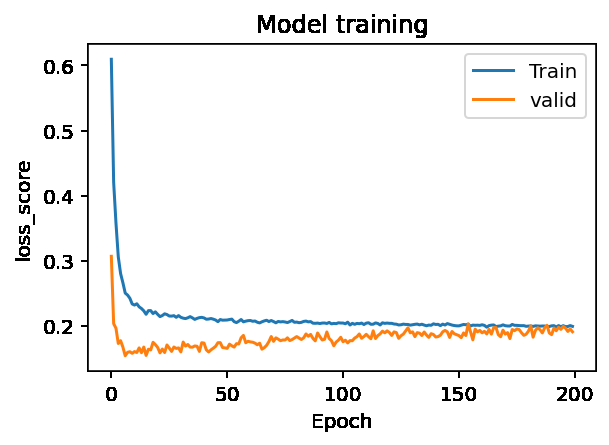

In [320]:
# Plot training & validation acc values
plt.figure(figsize=(10, 3))
plt.subplot(121)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model training')
plt.ylabel('loss_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'valid'], loc='upper right')
plt.show()

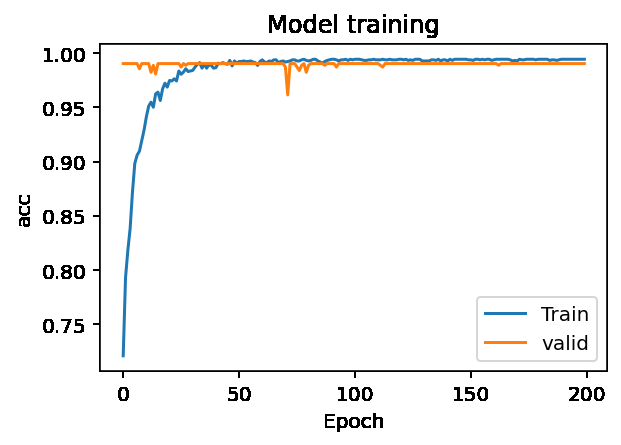

In [321]:
# Plot training & validation acc values
plt.figure(figsize=(10, 3))
plt.subplot(121)
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('Model training')
plt.ylabel('acc')
plt.xlabel('Epoch')
plt.legend(['Train', 'valid'], loc='lower right')
plt.show()

In [322]:
test_predictions = model.predict(test_X)

In [323]:
test_dataset.obsm["predicted_gene"] = test_predictions

Populating the interactive namespace from numpy and matplotlib

ENSMUSG00000031425:


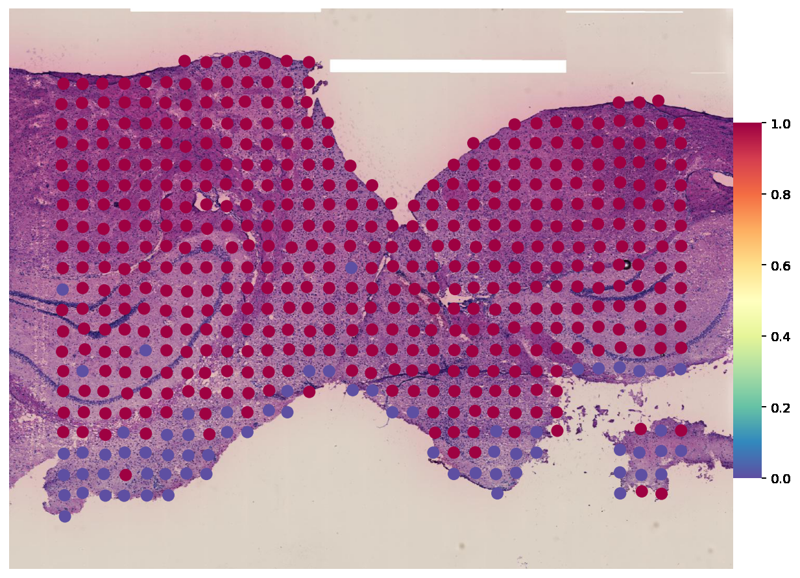


ENSMUSG00000024411:


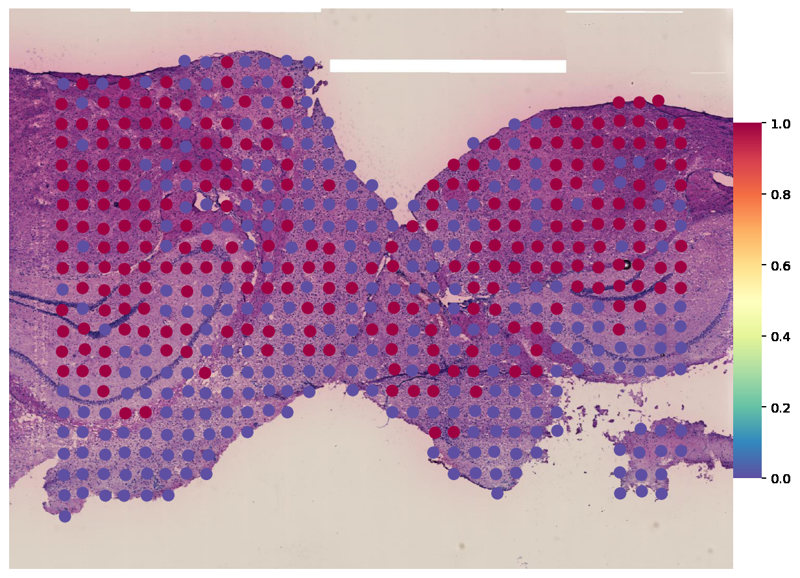


ENSMUSG00000026830:


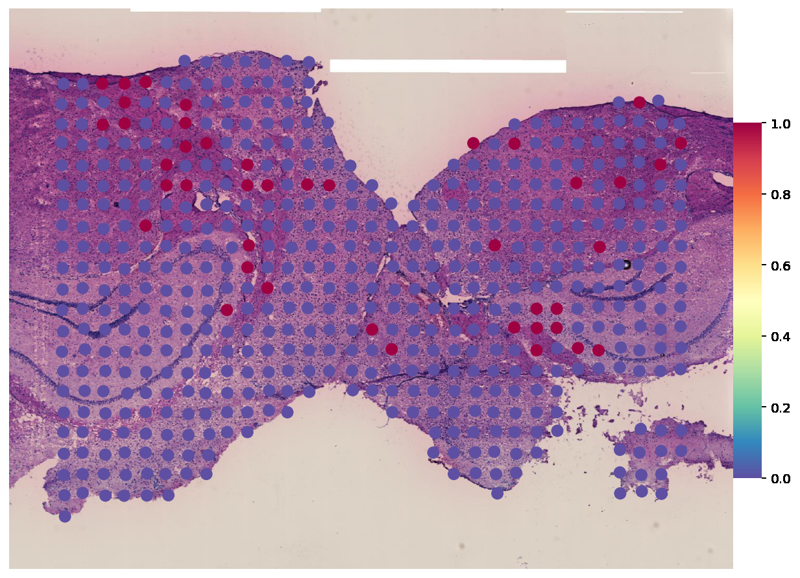


ENSMUSG00000090698:


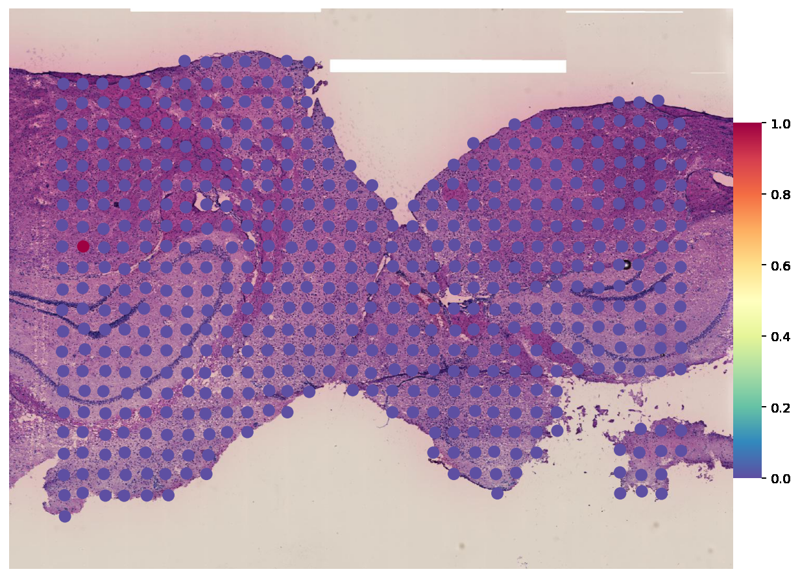


ENSMUSG00000018930:


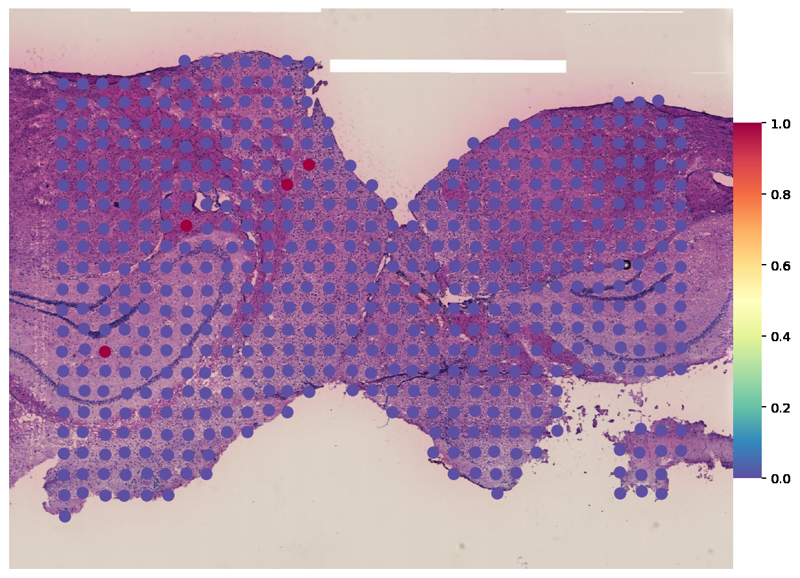


ENSMUSG00000042453:


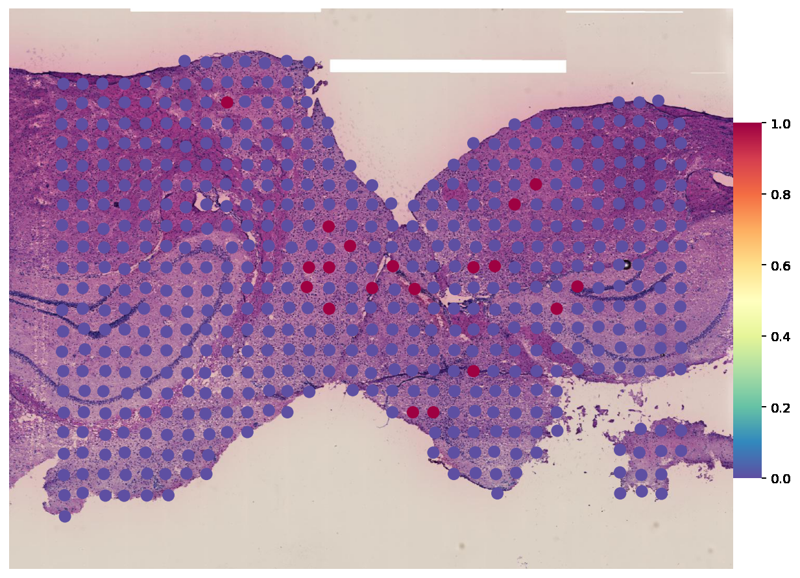


ENSMUSG00000029231:


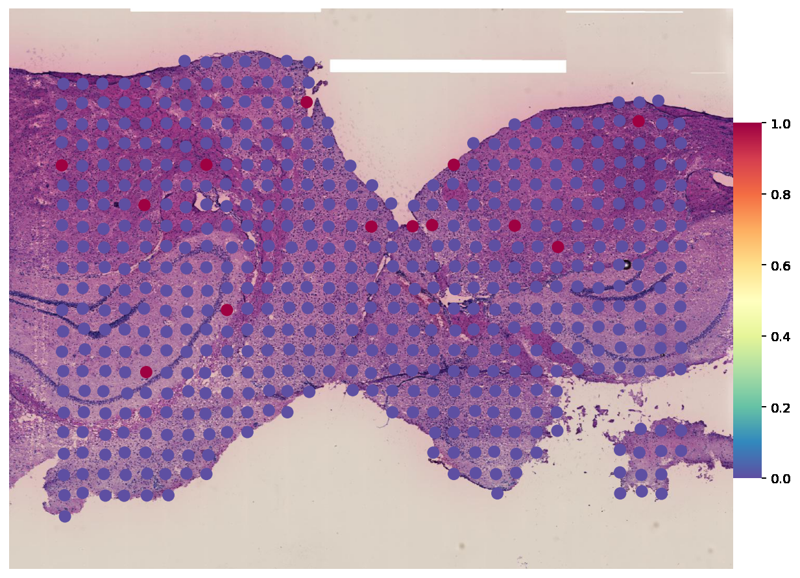


ENSMUSG00000054889:


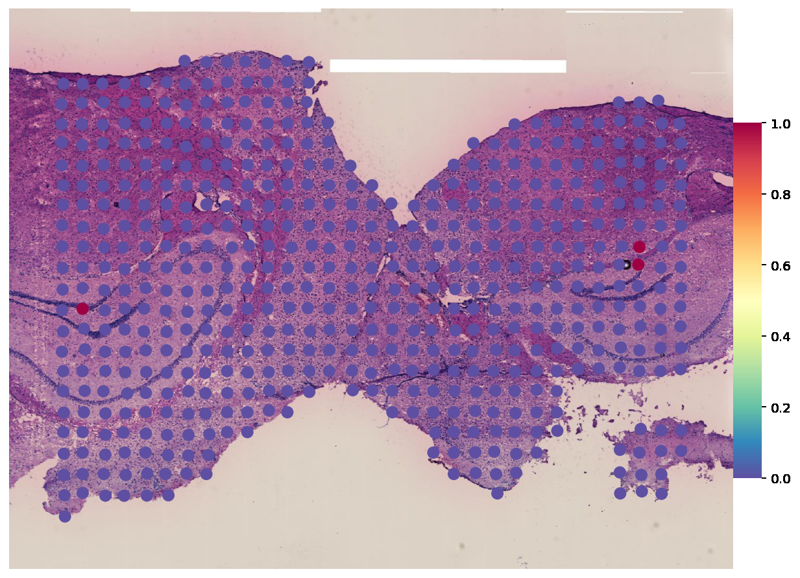


ENSMUSG00000031425:


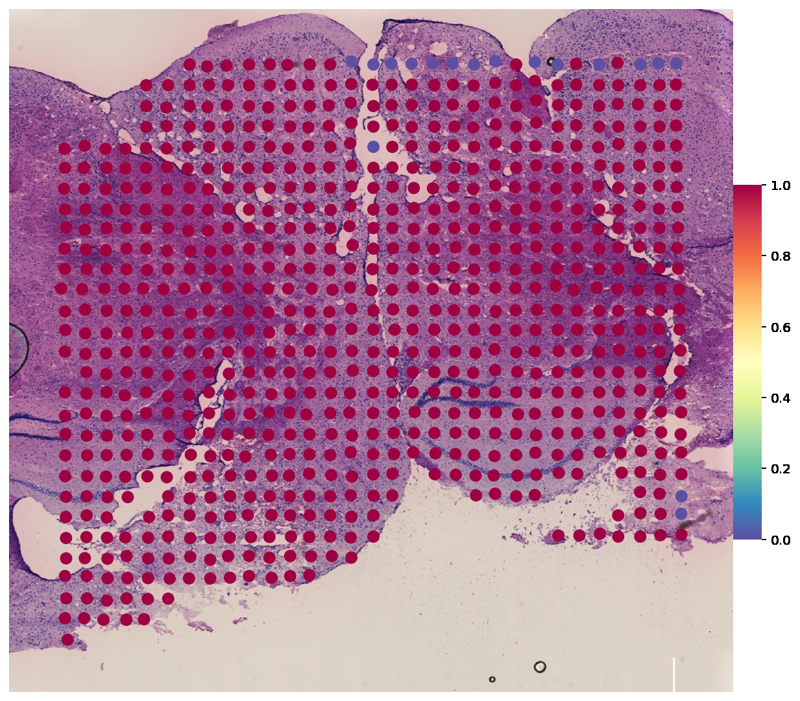


ENSMUSG00000024411:


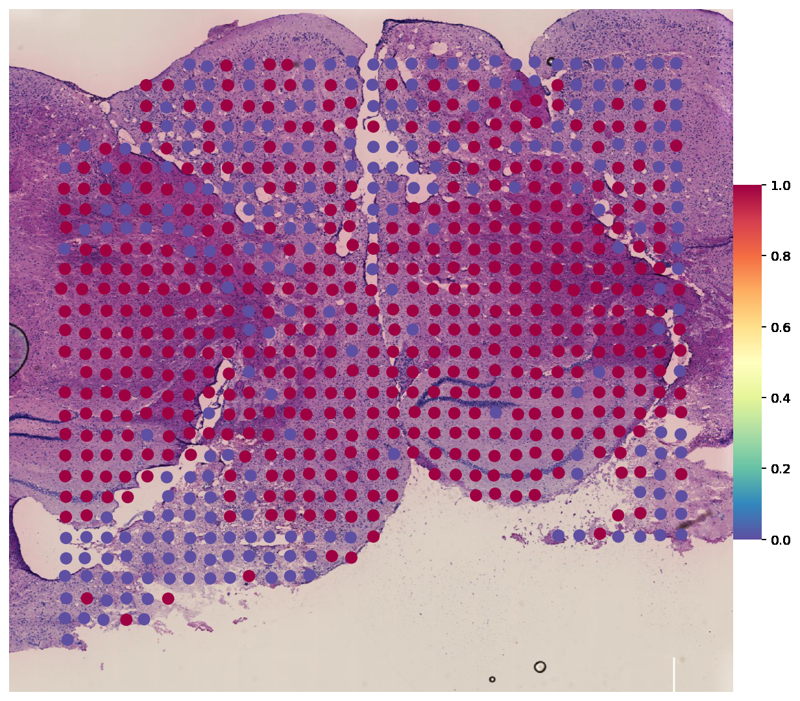


ENSMUSG00000026830:


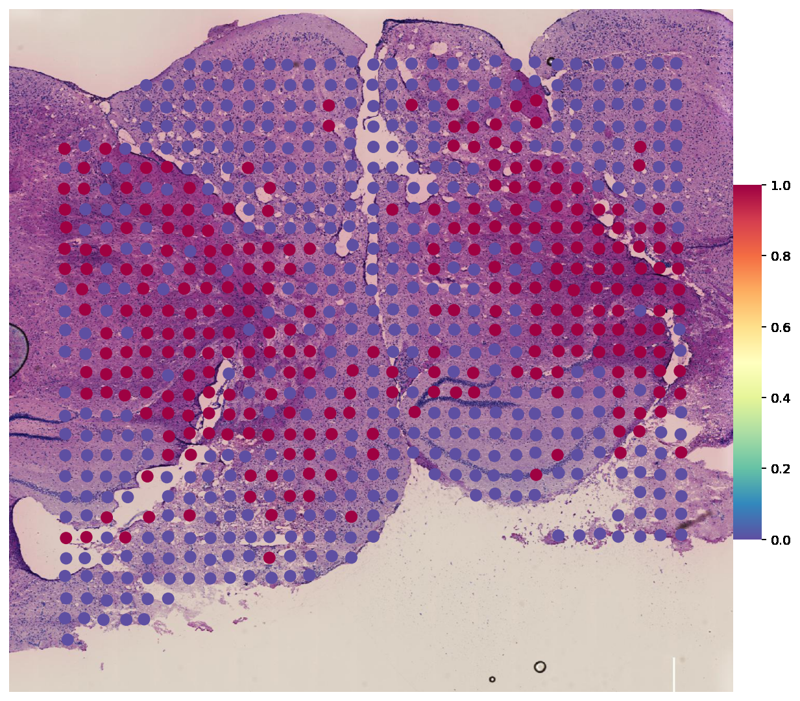


ENSMUSG00000090698:


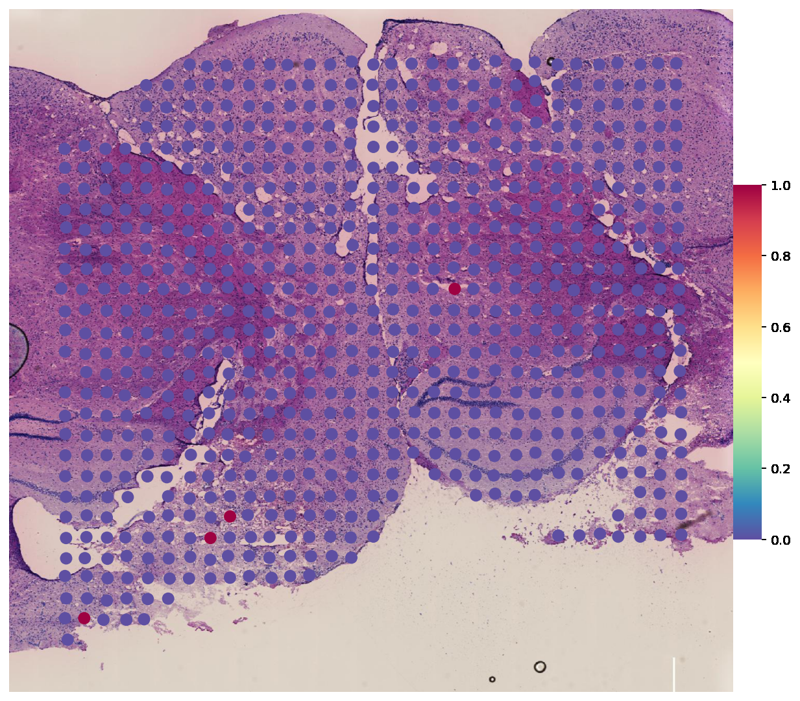


ENSMUSG00000018930:


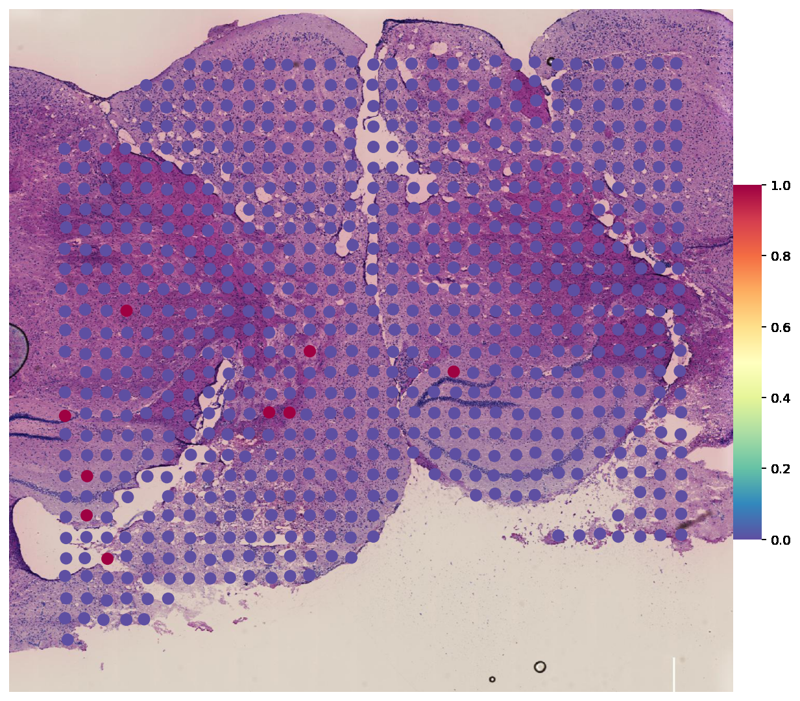


ENSMUSG00000042453:


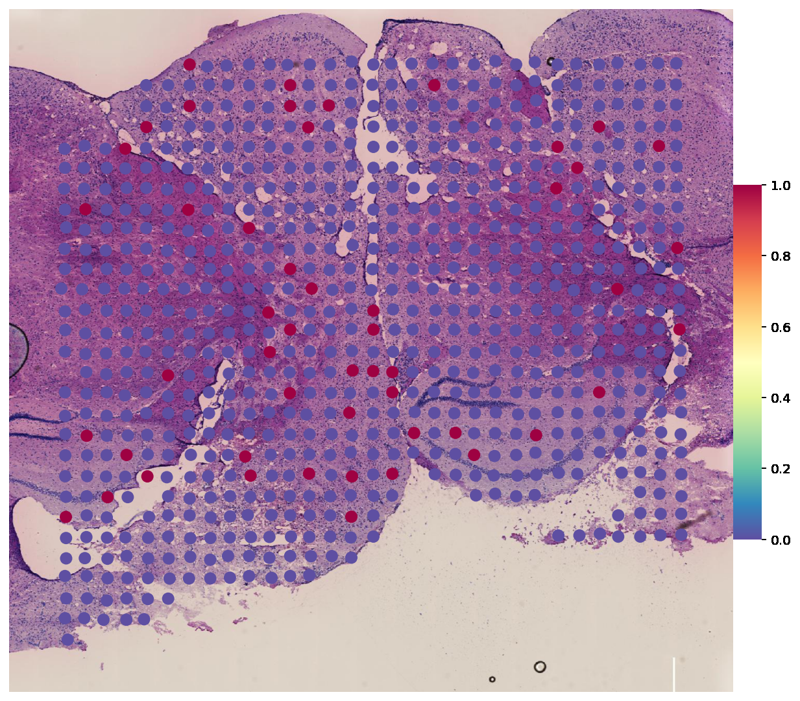


ENSMUSG00000029231:


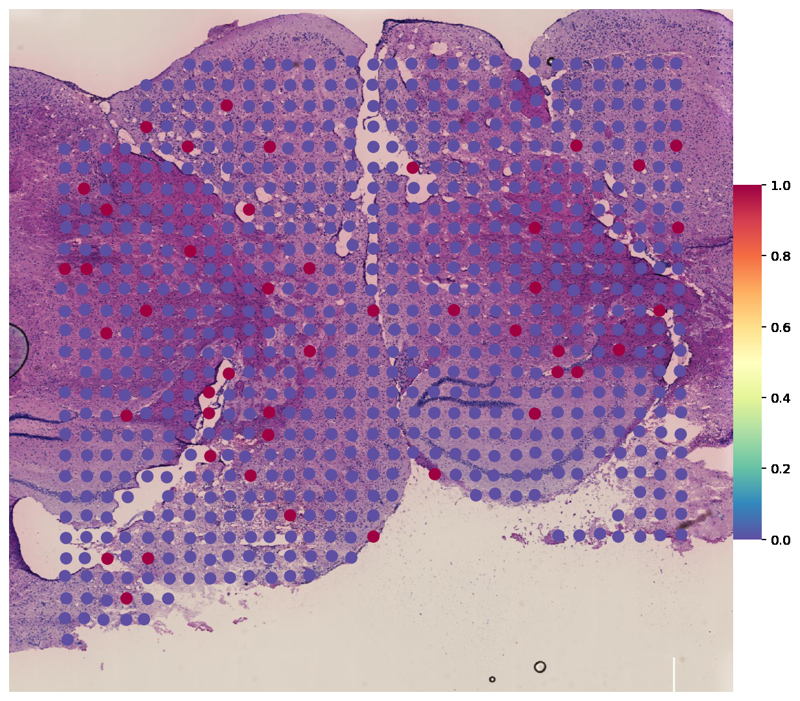


ENSMUSG00000054889:


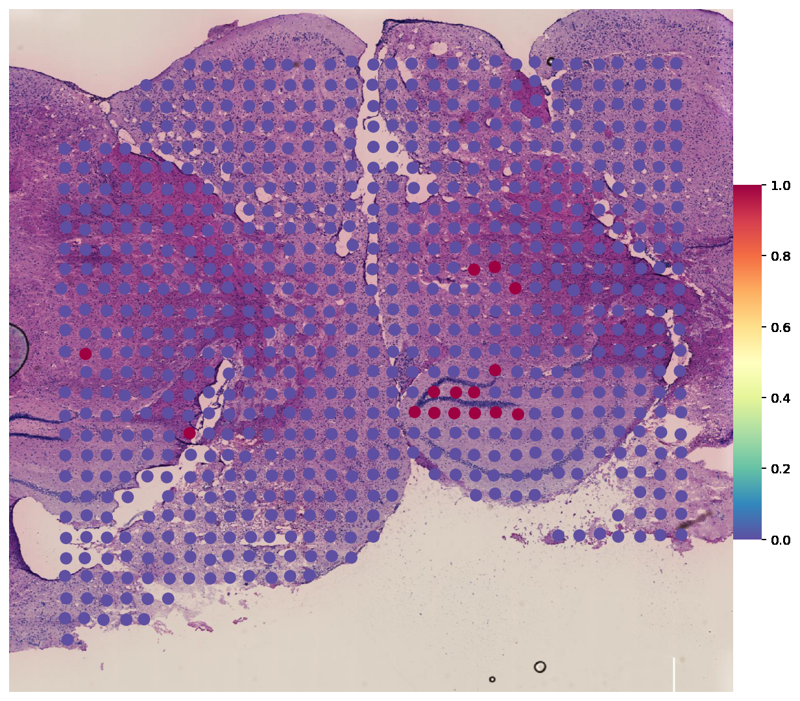

In [324]:
%pylab inline
figsize(10, 10)
for i, library in enumerate(
    ["Sample5", "Sample6"]
):
    ad = test_dataset[test_dataset.obs.library_id == library, :].copy()
    for i, g in enumerate(gene_list):
        print('\n'+gene_list[i]+':')
        gene_plot(ad, genes=gene_list[i], spot_size=90, library_id=library)

In [325]:
test_dataset_ = test_dataset[:,gene_list].copy()

In [326]:
test_dataset_.X = test_predictions

Populating the interactive namespace from numpy and matplotlib

ENSMUSG00000031425:


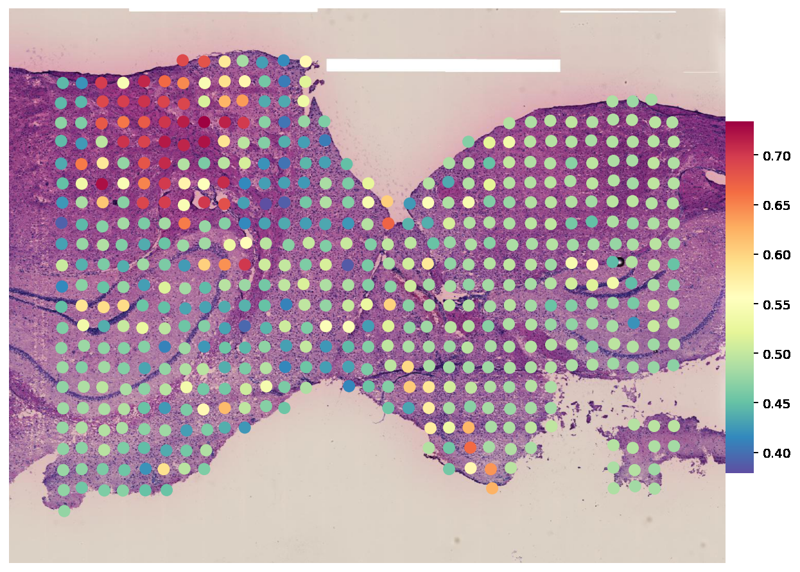


ENSMUSG00000024411:


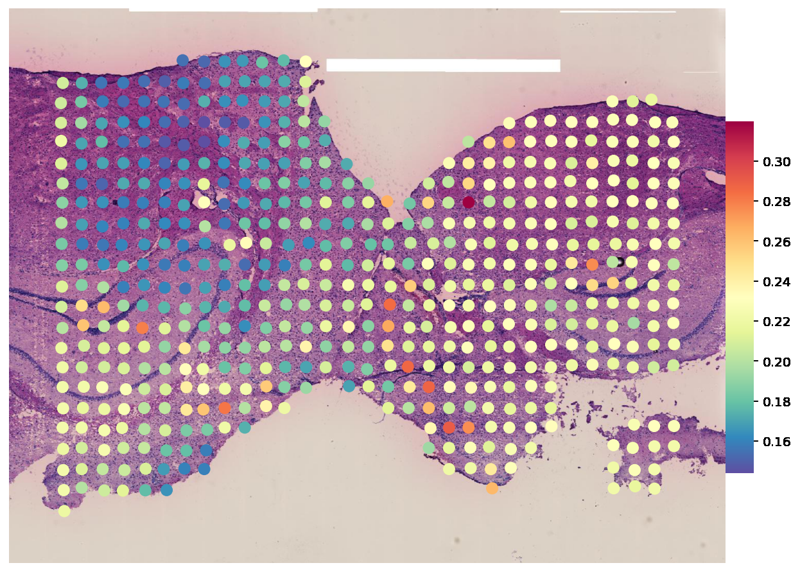


ENSMUSG00000026830:


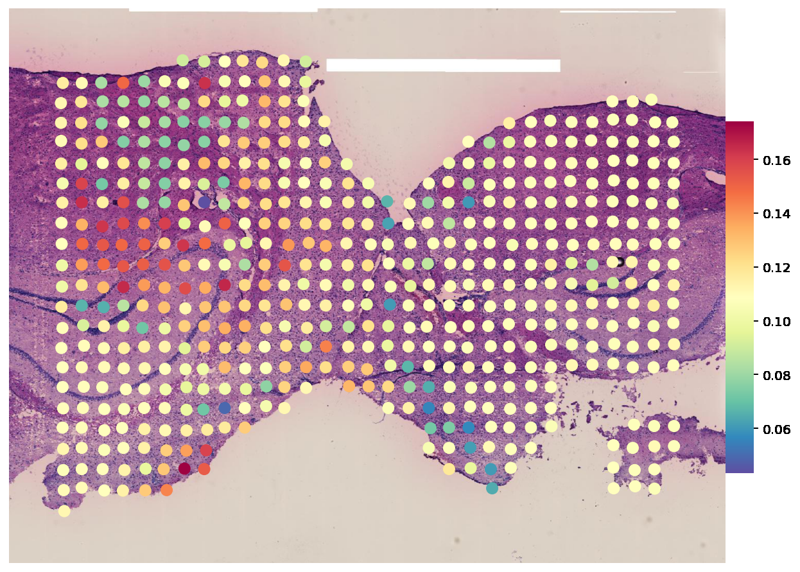


ENSMUSG00000090698:


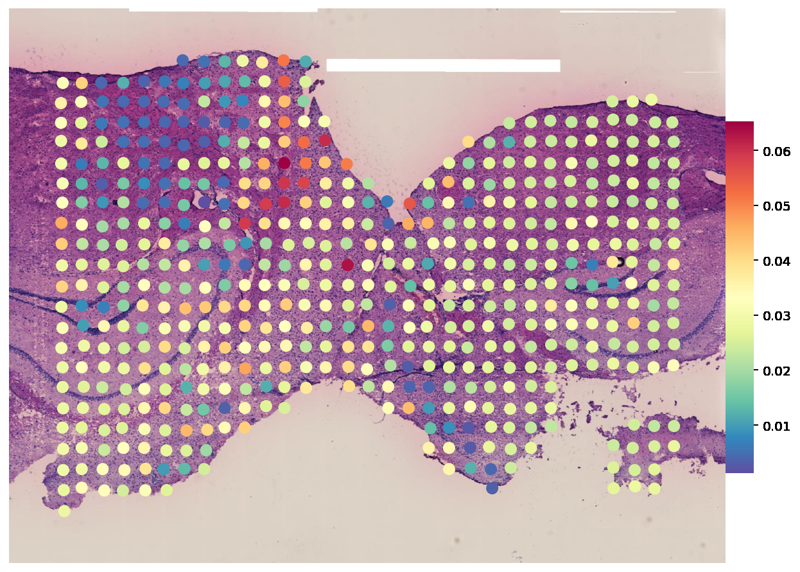


ENSMUSG00000018930:


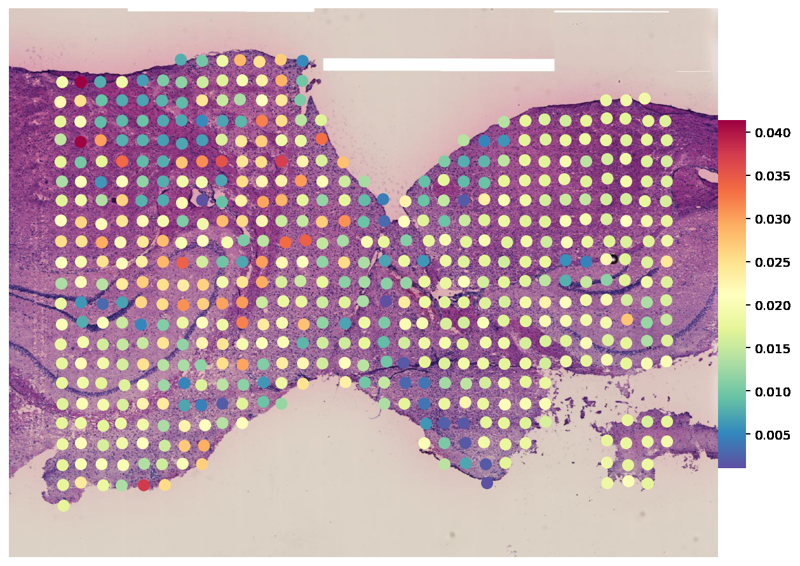


ENSMUSG00000042453:


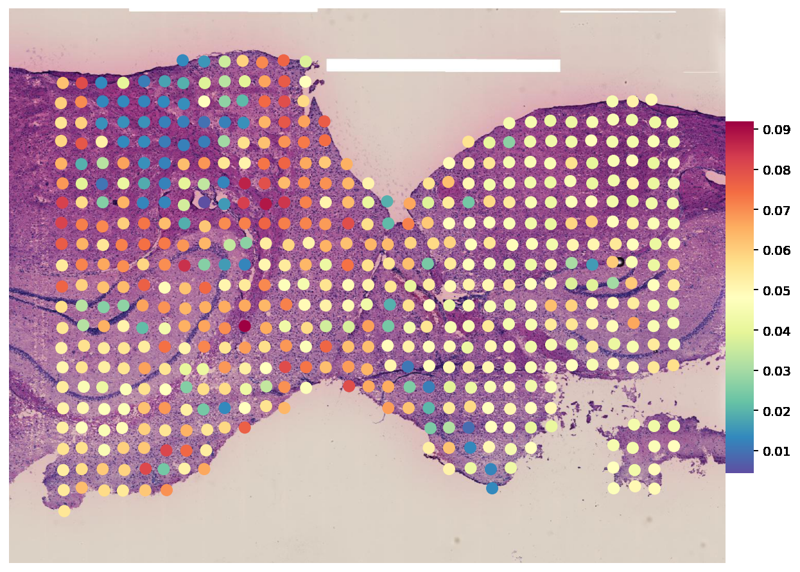


ENSMUSG00000029231:


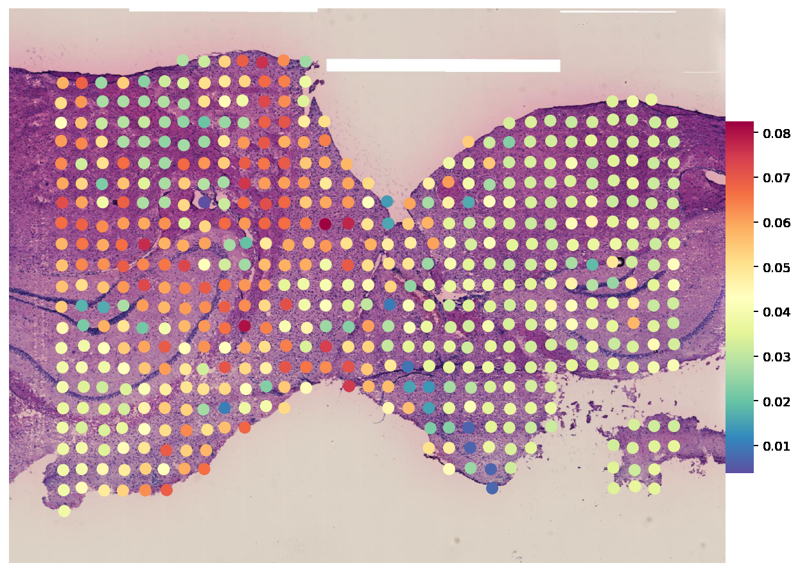


ENSMUSG00000054889:


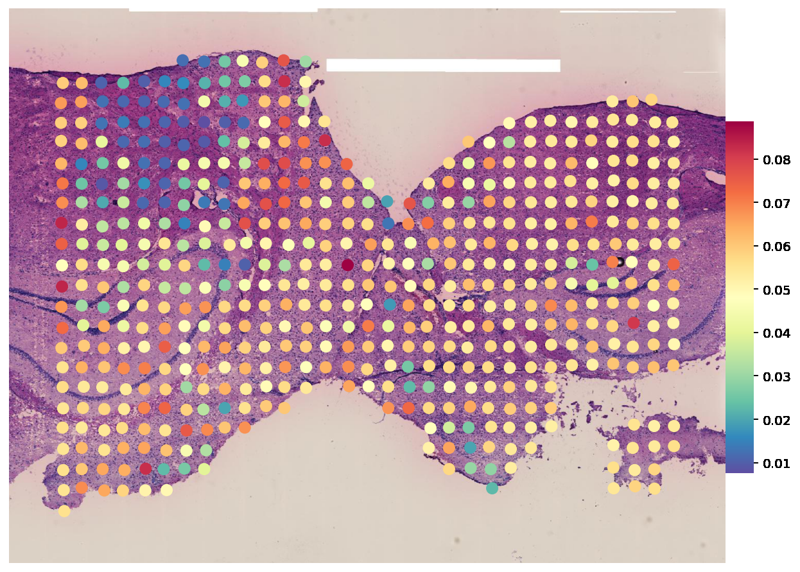


ENSMUSG00000031425:


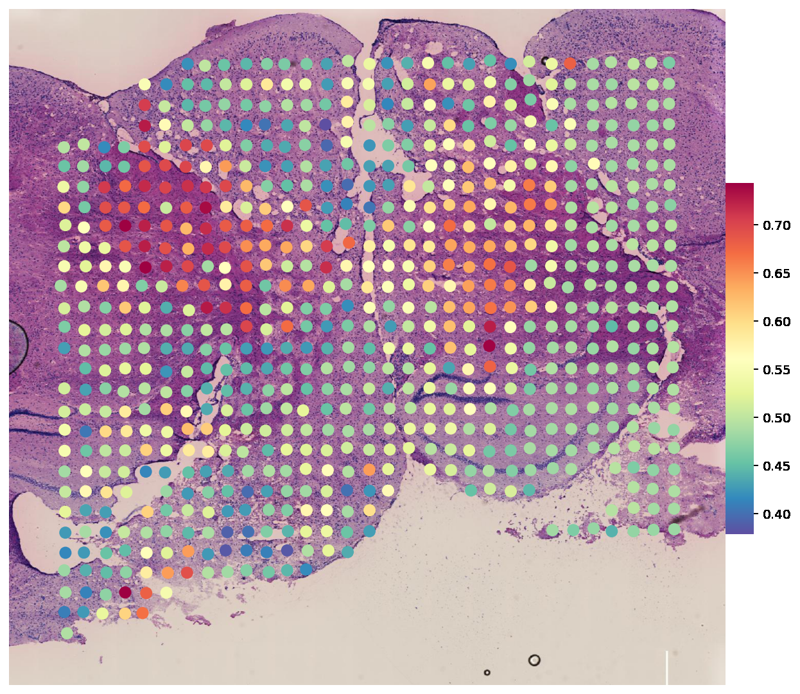


ENSMUSG00000024411:


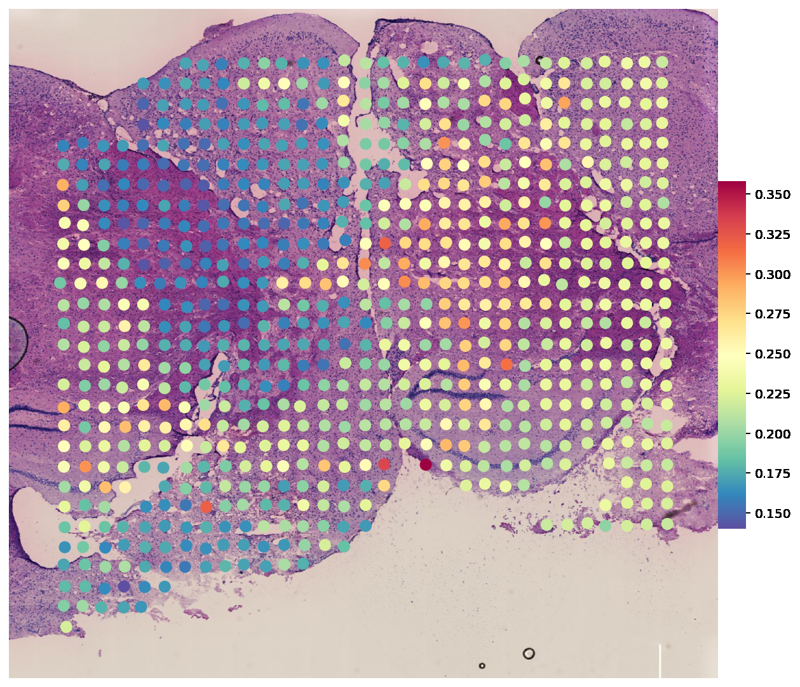


ENSMUSG00000026830:


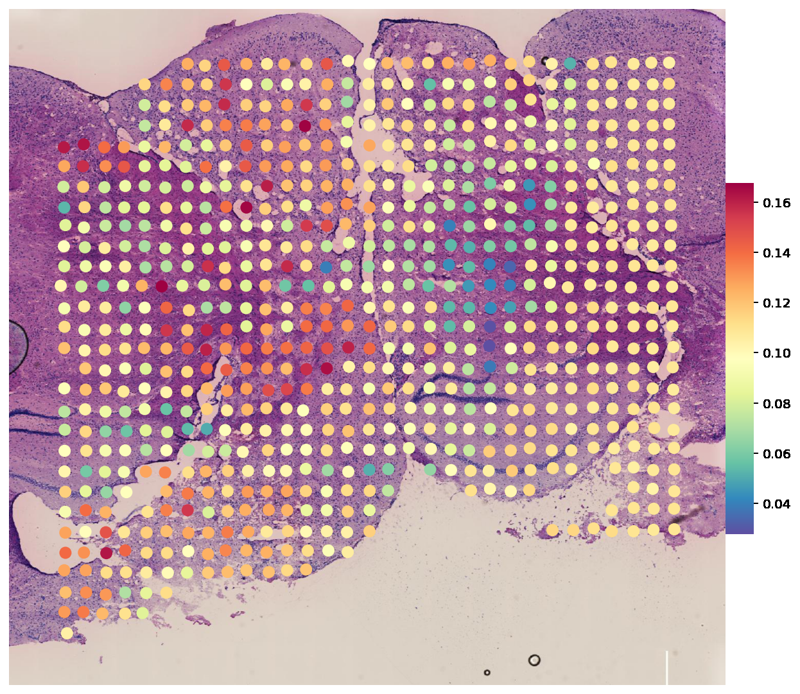


ENSMUSG00000090698:


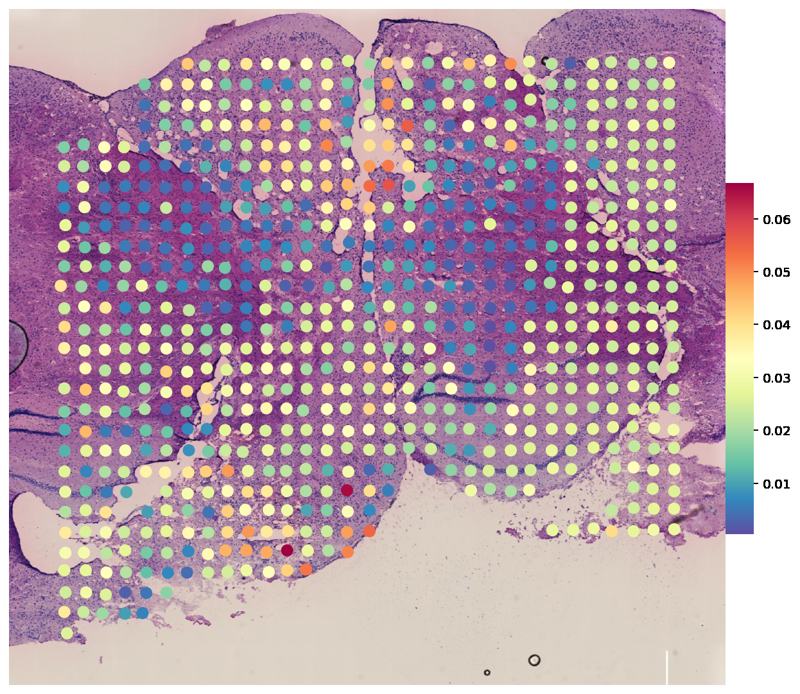


ENSMUSG00000018930:


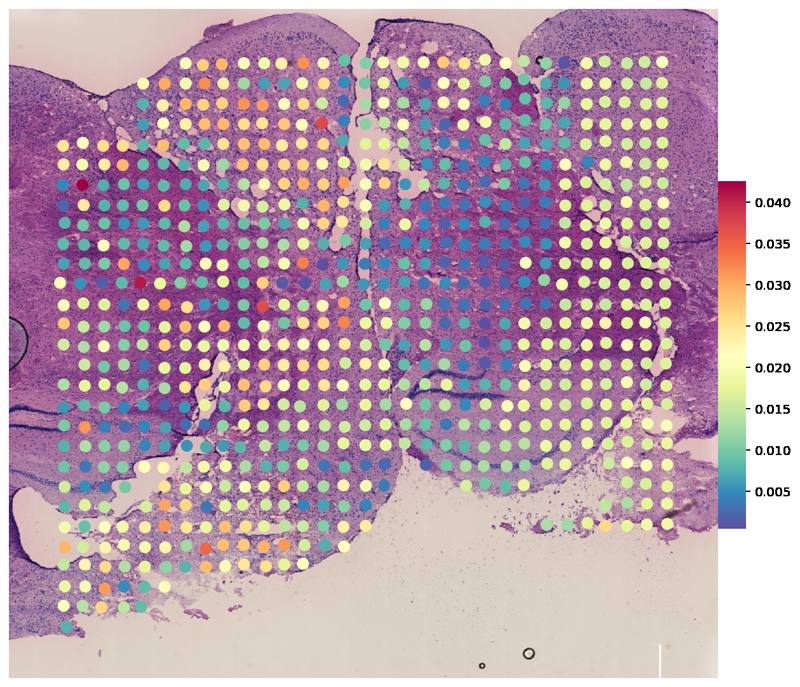


ENSMUSG00000042453:


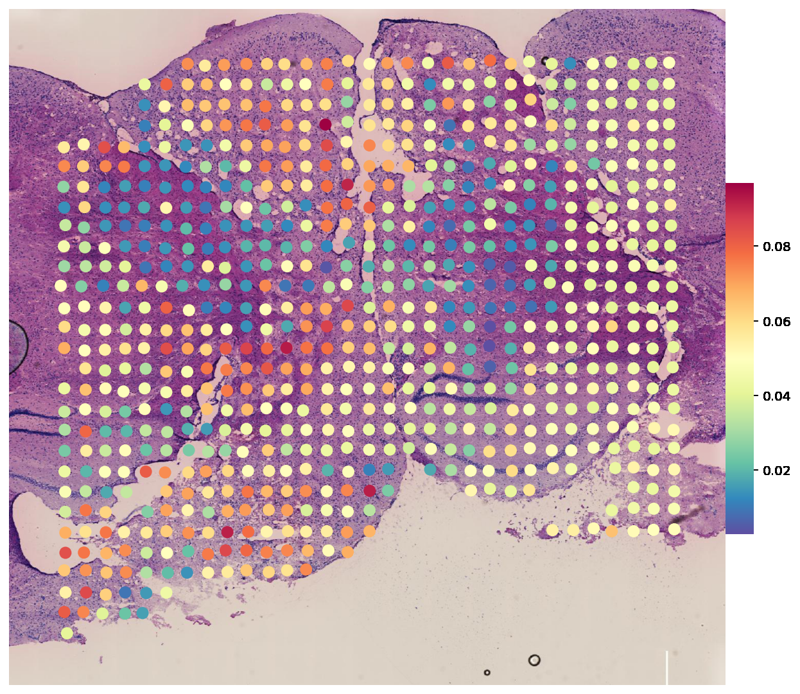


ENSMUSG00000029231:


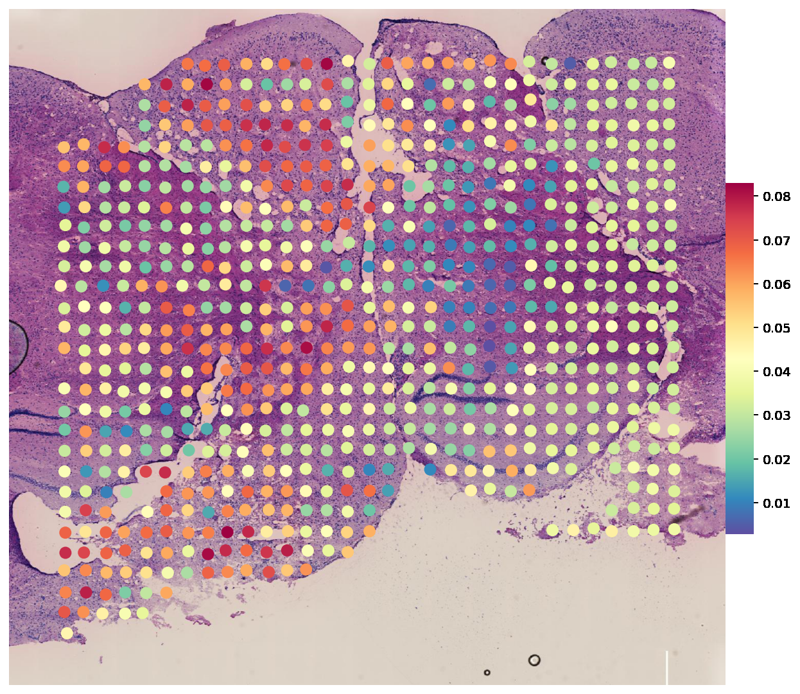


ENSMUSG00000054889:


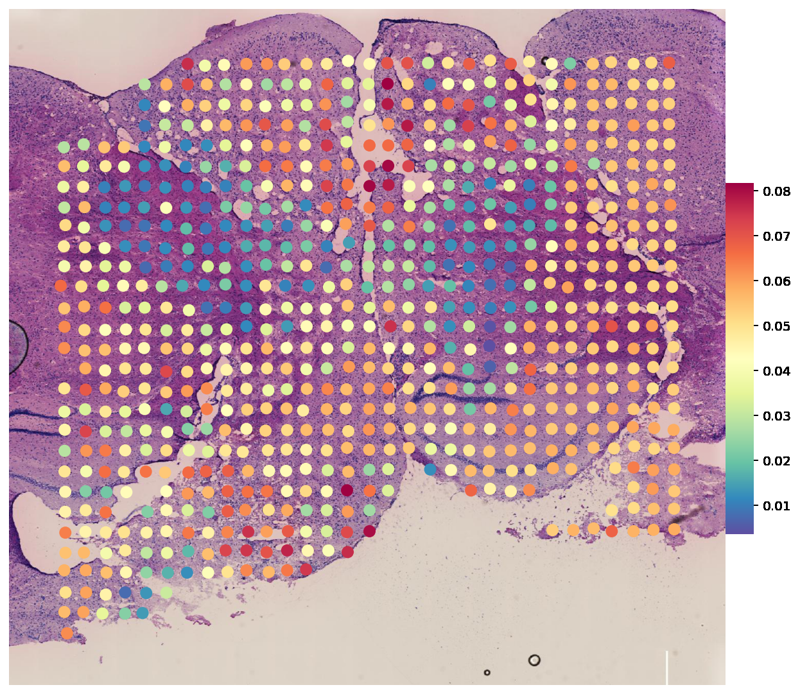

In [327]:
%pylab inline
figsize(10, 10)
for i, library in enumerate(
    ["Sample5", "Sample6"]
):
    ad = test_dataset_[test_dataset_.obs.library_id == library, :].copy()
    for i, g in enumerate(gene_list):
        print('\n'+gene_list[i]+':')
        gene_plot(ad, genes=gene_list[i], spot_size=90, library_id=library)